# 복합 노이즈 데이터에 대한 드리프트 분석 및 모델 성능 평가

다양한 노이즈가 적용된 이미지, 혹은 다양한 노이즈 데이터가 포함된 데이터셋에 대한 드리프트 현상 분석과 추론모델의 성능변화 관측

## 실험 1

다양한 노이즈 데이터가 포함된 데이터 덤프에 대한 분석<br>

* Test Dataset<br>
    12792개의 무작위 종류, 무작위 강도의 노이즈 이미지 데이터로 이루어진 데이터셋

* Current Dataset<br>
    학습용 노이즈 데이터 전체를 병합한 76752개 이미지 데이터셋

#### 부가 작업 1

생성된 데이터셋의 경로 문제 수정

In [1]:
import fiftyone as fo

fo.list_datasets()

['bright_current',
 'bright_merged',
 'bright_test',
 'dark_current',
 'dark_merged',
 'dark_test',
 'gaus_current',
 'gaus_test',
 'jpeg_compression_current',
 'jpeg_compression_merged',
 'jpeg_compression_test',
 'motion_blur_current',
 'motion_blur_merged',
 'motion_blur_test',
 'noise_composite_current',
 'snp_current',
 'snp_merged',
 'snp_test',
 'tunelpdr_merged_all']

In [2]:
def get_51_dataset(name, path, source):
    dataset = fo.Dataset(name)
    splits = ['train', 'val', 'test']

    for split in splits:
        dataset.add_dir(
            dataset_dir=path,
            dataset_type=fo.types.YOLOv5Dataset,
            split=split,
            tags=split,
        )

    for sample in dataset:
        sample['source'] = source
        sample.save()

    return dataset

In [3]:
import os

gscur_name = "gaus_current"
gstest_name = "gaus_test"
gscur_path = os.path.join("../datasets/", gscur_name)
gstest_path = os.path.join("../datasets/", gstest_name)

gaus_cur_dataset = get_51_dataset(gscur_name, gscur_path, 'current')
gaus_test_dataset = get_51_dataset(gstest_name, gstest_path, "test")

 100% |███████████████| 8954/8954 [9.2s elapsed, 0s remaining, 1.1K samples/s]       
 100% |███████████████| 2558/2558 [2.8s elapsed, 0s remaining, 885.7 samples/s]      
 100% |███████████████| 1280/1280 [1.4s elapsed, 0s remaining, 918.6 samples/s]         
 100% |███████████████| 8954/8954 [9.2s elapsed, 0s remaining, 1.1K samples/s]       
 100% |███████████████| 2558/2558 [2.9s elapsed, 0s remaining, 901.9 samples/s]      
 100% |███████████████| 1280/1280 [1.4s elapsed, 0s remaining, 927.3 samples/s]         


In [12]:
from tqdm import tqdm

# snp_current 데이터셋 로드
snp_current = fo.load_dataset("snp_current")
snp_test = fo.load_dataset("snp_test")

# filepath 수정
for dataset in [snp_current, snp_test]:
    for sample in tqdm(dataset, desc=f"{dataset.name} 처리 중"):
        if dataset.name == "snp_current" and 's&p_cur' in sample.filepath:
            new_filepath = sample.filepath.replace('s&p_cur', 'snp_current')
            sample.filepath = new_filepath
            sample.save()
        elif dataset.name == "snp_test" and 's&p_test' in sample.filepath:
            new_filepath = sample.filepath.replace('s&p_test', 'snp_test')
            sample.filepath = new_filepath
            sample.save()

print("파일 경로 수정 완료")

snp_test 처리 중: 100%|██████████| 12792/12792 [00:13<00:00, 943.08it/s] 

파일 경로 수정 완료


### 복합 노이즈 데이터셋 생성

Current Data : 일정한 강도로 적용된 4종류의 노이즈 데이터로 구성

In [4]:
import fiftyone as fo

fo.list_datasets()

['bright_current',
 'bright_merged',
 'bright_test',
 'dark_current',
 'dark_merged',
 'dark_test',
 'gaus_current',
 'gaus_test',
 'jpeg_compression_current',
 'jpeg_compression_merged',
 'jpeg_compression_test',
 'motion_blur_current',
 'motion_blur_merged',
 'motion_blur_test',
 'snp_current',
 'snp_merged',
 'snp_test',
 'tunelpdr_merged_all']

In [3]:
# fo.delete_dataset('noise_composite_current')
# fo.delete_dataset('noise_composite_test')
# fo.delete_dataset('noise_composite_train')
# fo.delete_dataset('noise_composite_val')

In [5]:
from tqdm.notebook import tqdm

noise_types = ['gaus', 'snp', 'motion_blur', 'dark']
samples_per_type = 12792 // len(noise_types)  # 각 타입당 3198개
merged_dataset = fo.Dataset("noise_composite_current")

# 각 노이즈 타입별로 샘플 추출 및 병합
for noise_type in tqdm(noise_types, desc="노이즈 타입 처리 중",):
    # 현재 노이즈 타입의 데이터셋 로드
    current_dataset = fo.load_dataset(f"{noise_type}_current")
    # 무작위로 samples_per_type개의 샘플 선택
    selected_samples = current_dataset.shuffle().limit(samples_per_type)
    total_samples = len(selected_samples)
    # 선택된 샘플들을 새로운 데이터셋에 추가
    for sample in tqdm(selected_samples.iter_samples(), desc=f"{noise_type} 샘플 추가 중", total=total_samples, leave=False):
        sample['noise_type'] = noise_type  # 노이즈 타입 정보 추가
        merged_dataset.add_sample(sample)

print(f"생성된 데이터셋 크기: {len(merged_dataset)} 샘플")
print(f"각 노이즈 타입별 샘플 수: {samples_per_type}")

노이즈 타입 처리 중:   0%|          | 0/4 [00:00<?, ?it/s]

gaus 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

snp 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

motion_blur 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

dark 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

생성된 데이터셋 크기: 12792 샘플
각 노이즈 타입별 샘플 수: 3198


In [6]:
import os
import json
import random

export_dir = "../datasets/noise_composite_current"
splits = ['train', 'val', 'test']
split_ratios = [0.7, 0.2, 0.1]  # train/val/test 비율

dataset = fo.load_dataset("noise_composite_current")
all_samples = list(dataset)
random.shuffle(all_samples)

total_samples = len(all_samples)
train_size = int(total_samples * split_ratios[0])
val_size = int(total_samples * split_ratios[1])

train_samples = all_samples[:train_size]
val_samples = all_samples[train_size:train_size + val_size]
test_samples = all_samples[train_size + val_size:]

split_datasets = []
metadata = {split: {} for split in splits}

for split, samples in zip(splits, [train_samples, val_samples, test_samples]):

    split_dataset = fo.Dataset(f"noise_composite_{split}")
    # 샘플 추가
    for sample in samples:
        split_dataset.add_sample(sample)
        metadata[split][sample.filepath] = sample.noise_type
    # YOLOv5 형식으로 내보내기
    split_dataset.export(
        export_dir=export_dir,
        dataset_type=fo.types.YOLOv5Dataset,
        split=split,
    )
    split_datasets.append(split_dataset)

# noise_type 메타데이터를 JSON 파일로 저장
metadata_path = os.path.join(export_dir, "noise_type_metadata.json")
with open(metadata_path, 'w') as f:
    json.dump(metadata, f, indent=4)

print(f"데이터셋이 {export_dir}에 YOLOv5 형식으로 저장되었습니다.")
print(f"noise_type 메타데이터가 {metadata_path}에 저장되었습니다.")
print("\n분할 별 샘플 수:")
for split, split_dataset in zip(splits, split_datasets):
    print(f"{split}: {len(split_dataset)}")

 100% |███████████████| 8954/8954 [12.3s elapsed, 0s remaining, 757.5 samples/s]      
Directory '../datasets/noise_composite_current' already exists; export will be merged with existing files
 100% |███████████████| 2558/2558 [4.4s elapsed, 0s remaining, 754.7 samples/s]       
Directory '../datasets/noise_composite_current' already exists; export will be merged with existing files
 100% |███████████████| 1280/1280 [1.7s elapsed, 0s remaining, 749.8 samples/s]         
데이터셋이 ../datasets/noise_composite_current에 YOLOv5 형식으로 저장되었습니다.
noise_type 메타데이터가 ../datasets/noise_composite_current/noise_type_metadata.json에 저장되었습니다.

분할 별 샘플 수:
train: 8954
val: 2558
test: 1280


In [ ]:
fo.delete_dataset('noise_composite_test')
fo.delete_dataset('noise_composite_train')
fo.delete_dataset('noise_composite_val')

['bright_current',
 'bright_merged',
 'bright_test',
 'dark_current',
 'dark_merged',
 'dark_test',
 'gaus_current',
 'gaus_test',
 'jpeg_compression_current',
 'jpeg_compression_merged',
 'jpeg_compression_test',
 'motion_blur_current',
 'motion_blur_merged',
 'motion_blur_test',
 'noise_composite_current',
 'snp_current',
 'snp_merged',
 'snp_test',
 'tunelpdr_merged_all']

In [10]:
noise_types = ['gaus', 'snp', 'motion_blur', 'dark']
samples_per_type = 12792 // len(noise_types)  # 각 타입당 3198개
merged_dataset = fo.Dataset("noise_composite_test")

# 각 노이즈 타입별로 샘플 추출 및 병합
for noise_type in tqdm(noise_types, desc="노이즈 타입 처리 중",):
    # 현재 노이즈 타입의 데이터셋 로드
    test_dataset = fo.load_dataset(f"{noise_type}_test")
    # 무작위로 samples_per_type개의 샘플 선택
    selected_samples = test_dataset.shuffle().limit(samples_per_type)
    total_samples = len(selected_samples)
    # 선택된 샘플들을 새로운 데이터셋에 추가
    for sample in tqdm(selected_samples.iter_samples(), desc=f"{noise_type} 샘플 추가 중", total=total_samples, leave=False):
        sample['noise_type'] = noise_type  # 노이즈 타입 정보 추가
        merged_dataset.add_sample(sample)

print(f"생성된 데이터셋 크기: {len(merged_dataset)} 샘플")
print(f"각 노이즈 타입별 샘플 수: {samples_per_type}")

노이즈 타입 처리 중:   0%|          | 0/4 [00:00<?, ?it/s]

gaus 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

snp 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

motion_blur 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

dark 샘플 추가 중:   0%|          | 0/3198 [00:00<?, ?it/s]

생성된 데이터셋 크기: 12792 샘플
각 노이즈 타입별 샘플 수: 3198


In [1]:
import fiftyone as fo

fo.list_datasets()

['bright_current',
 'bright_merged',
 'bright_test',
 'dark_current',
 'dark_merged',
 'dark_test',
 'gaus_current',
 'gaus_test',
 'jpeg_compression_current',
 'jpeg_compression_merged',
 'jpeg_compression_test',
 'motion_blur_current',
 'motion_blur_merged',
 'motion_blur_test',
 'noise_composite_current',
 'noise_composite_test',
 'snp_current',
 'snp_merged',
 'snp_test',
 'tunelpdr_merged_all']

In [12]:
import torch
import clip
import numpy as np
from tqdm.notebook import tqdm
import fiftyone.brain as fob

def get_embeddings(dataset, device, model, preprocess):

    for sample in tqdm(dataset, desc=f"{dataset.name} 임베딩 계산 중"):
        with torch.no_grad():
            inputs = preprocess(Image.open(sample.filepath)).unsqueeze(0).to(device)
            embedding = model.encode_image(inputs).cpu().numpy().flatten()
            sample['clip_embeddings'] = embedding.tolist()
            sample.save()
    
def collect_image_embeddings_by_sample_id(dataset):

    print(f"Collecting image embeddings by sample ID for {dataset.name}")
    image_embeddings = {}
    for sample in dataset:
        sample_id = sample.id
        if 'clip_embeddings' in sample:
            # 샘플 ID를 키로, 이미지 임베딩을 값으로 저장
            image_embeddings[sample_id] = np.array(sample['clip_embeddings'])

    return image_embeddings

In [7]:
ref_dataset = fo.load_dataset('tunelpdr_merged_all')
cur_dataset = fo.load_dataset('noise_composite_current')
test_dataset = fo.load_dataset('noise_composite_test')

for sample in ref_dataset:
    sample['source'] = 'ref'
    sample.save()

for sample in cur_dataset:
    sample['source'] = 'current'
    sample.save()

for sample in test_dataset:
    sample['source'] = 'test'
    sample.save()

In [10]:
merged_dataset = fo.Dataset('noise_composite_merged')

merged_dataset.add_samples(ref_dataset)
merged_dataset.add_samples(cur_dataset)
merged_dataset.add_samples(test_dataset)

merged_dataset

 100% |█████████████| 12792/12792 [24.0s elapsed, 0s remaining, 500.9 samples/s]      
 100% |█████████████| 12792/12792 [24.5s elapsed, 0s remaining, 547.4 samples/s]      
 100% |█████████████| 12792/12792 [24.2s elapsed, 0s remaining, 535.0 samples/s]      


Name:        noise_composite_merged
Media type:  image
Num samples: 38376
Persistent:  False
Tags:        []
Sample fields:
    id:               fiftyone.core.fields.ObjectIdField
    filepath:         fiftyone.core.fields.StringField
    tags:             fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:         fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    created_at:       fiftyone.core.fields.DateTimeField
    last_modified_at: fiftyone.core.fields.DateTimeField
    ground_truth:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    source:           fiftyone.core.fields.StringField
    noise_type:       fiftyone.core.fields.StringField

In [16]:
from PIL import Image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model, preprocess = clip.load("ViT-B/16", device=device)

get_embeddings(merged_dataset, device, model, preprocess)
embeddings_by_sample_id = collect_image_embeddings_by_sample_id(merged_dataset)

results = fob.compute_visualization(
    merged_dataset,
    embeddings=embeddings_by_sample_id,
    brain_key="clip_embeddings",
    plot_points=True,
    verbose=True,
)

noise_composite_merged 임베딩 계산 중:   0%|          | 0/38376 [00:00<?, ?it/s]

Generating visualization...


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


UMAP( verbose=True)
Thu Feb 27 11:42:27 2025 Construct fuzzy simplicial set
Thu Feb 27 11:42:27 2025 Finding Nearest Neighbors
Thu Feb 27 11:42:27 2025 Building RP forest with 15 trees
Thu Feb 27 11:42:33 2025 NN descent for 15 iterations
	 1  /  15
	 2  /  15
	 3  /  15
	 4  /  15
	Stopping threshold met -- exiting after 4 iterations
Thu Feb 27 11:42:42 2025 Finished Nearest Neighbor Search
Thu Feb 27 11:42:42 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu Feb 27 11:42:49 2025 Finished embedding


In [17]:
session = fo.launch_app(merged_dataset)

In [18]:
import fiftyone as fo

fo.list_datasets()

['bright_current',
 'bright_merged',
 'bright_test',
 'dark_current',
 'dark_merged',
 'dark_test',
 'gaus_current',
 'gaus_test',
 'jpeg_compression_current',
 'jpeg_compression_merged',
 'jpeg_compression_test',
 'motion_blur_current',
 'motion_blur_merged',
 'motion_blur_test',
 'noise_composite_current',
 'noise_composite_merged',
 'noise_composite_test',
 'snp_current',
 'snp_merged',
 'snp_test',
 'tunelpdr_merged_all']

In [19]:
merged_dataset = fo.load_dataset("noise_composite_merged")

In [24]:
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from scipy.stats import gaussian_kde

def calculate_mmd_batch(X, Y, batch_size=1000, gamma=None):
    """
    배치 처리를 통한 MMD 계산
    """
    # 배치 크기 조정
    batch_size = min(batch_size, min(len(X), len(Y)))
    
    # 랜덤 샘플링
    if len(X) > batch_size:
        idx = np.random.choice(len(X), batch_size, replace=False)
        X = X[idx]
    if len(Y) > batch_size:
        idx = np.random.choice(len(Y), batch_size, replace=False)
        Y = Y[idx]
    
    if gamma is None:
        # 중간값 휴리스틱 사용 (배치 데이터 기준)
        X_combined = np.vstack([X[:batch_size], Y[:batch_size]])
        pairwise_dists = np.sum((X_combined[:, np.newaxis] - X_combined) ** 2, axis=2)
        gamma = 1.0 / np.median(pairwise_dists[pairwise_dists > 0])

    def kernel(X, Y):
        # RBF 커널
        X_norm = np.sum(X ** 2, axis=1)
        Y_norm = np.sum(Y ** 2, axis=1)
        distances = X_norm[:, np.newaxis] + Y_norm - 2 * np.dot(X, Y.T)
        return np.exp(-gamma * distances)

    K_XX = kernel(X, X)
    K_YY = kernel(Y, Y)
    K_XY = kernel(X, Y)

    n_X = X.shape[0]
    n_Y = Y.shape[0]

    mmd = (np.sum(K_XX) - np.trace(K_XX)) / (n_X * (n_X - 1))
    mmd += (np.sum(K_YY) - np.trace(K_YY)) / (n_Y * (n_Y - 1))
    mmd -= 2 * np.mean(K_XY)

    return np.sqrt(max(mmd, 0))

def visualize_fixed_projection_drift(ref_data, cur_data, test_data, title="임베딩 드리프트 비교"):
    """
    고정된 프로젝션으로 드리프트 시각화
    """
    # 1. MMD 점수 계산
    ref_mmd = calculate_mmd_batch(test_data, ref_data, batch_size=1000)
    cur_mmd = calculate_mmd_batch(test_data, cur_data, batch_size=1000)
    
    # 2. PCA 및 시각화
    pca = PCA(n_components=2)
    pca.fit(test_data)
    
    test_transformed = pca.transform(test_data)
    ref_transformed = pca.transform(ref_data)
    cur_transformed = pca.transform(cur_data)
    
    all_transformed = np.vstack([test_transformed, ref_transformed, cur_transformed])
    x_min, x_max = all_transformed[:, 0].min(), all_transformed[:, 0].max()
    y_min, y_max = all_transformed[:, 1].min(), all_transformed[:, 1].max()
    xx, yy = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    
    def calculate_density(data):
        kde = gaussian_kde(data.T)
        z = kde(positions).reshape(xx.shape)
        return z
    
    test_density = calculate_density(test_transformed)
    ref_density = calculate_density(ref_transformed)
    cur_density = calculate_density(cur_transformed)
    
    # 3. 시각화
    fig = plt.figure(figsize=(15, 6))  # 높이 약간 증가
    
    # 서브플롯 그리드 설정 (상단: 등고선, 하단: MMD 점수)
    gs = plt.GridSpec(2, 3, height_ratios=[4, 1])
    
    # 등고선 그래프
    cmaps = ['Purples', 'Blues', 'Reds']
    titles = ['Test 데이터', 'Reference 데이터\nMMD: {:.4f}'.format(ref_mmd), 
             'Current 데이터\nMMD: {:.4f}'.format(cur_mmd)]
    densities = [test_density, ref_density, cur_density]
    transformed_data = [test_transformed, ref_transformed, cur_transformed]
    
    for idx, (density, data, cmap, subtitle) in enumerate(zip(densities, transformed_data, 
                                                            cmaps, titles)):
        ax = plt.subplot(gs[0, idx])
        contour = ax.contourf(xx, yy, density, levels=20, cmap=cmap)
        ax.scatter(data[:, 0], data[:, 1], c='black', alpha=0.1, s=1)
        plt.colorbar(contour, ax=ax, label='밀도')
        ax.set_title(subtitle)
    
    # MMD 점수 바 그래프
    ax_mmd = plt.subplot(gs[1, :])
    bars = ax_mmd.bar(['Reference vs Test', 'Current vs Test'], 
                     [ref_mmd, cur_mmd],
                     color=['blue', 'red'], alpha=0.6)
    ax_mmd.set_title('MMD 점수 비교')
    ax_mmd.set_ylabel('MMD Score')
    
    # 바 위에 값 표시
    for bar in bars:
        height = bar.get_height()
        ax_mmd.text(bar.get_x() + bar.get_width()/2., height,
                   f'{height:.4f}',
                   ha='center', va='bottom')
    
    # 전체 제목
    plt.suptitle(f'{title}\nPC1 설명력: {pca.explained_variance_ratio_[0]:.3f}, '
                f'PC2 설명력: {pca.explained_variance_ratio_[1]:.3f}')
    plt.tight_layout()
    
    return fig

def visualize_fixed_projection_drift_3d(ref_data, cur_data, test_data, title="3D 임베딩 드리프트 비교"):
    """
    3차원 공간에서 드리프트 시각화 (test 데이터 강조)
    """
    # 1. MMD 점수 계산
    ref_mmd = calculate_mmd_batch(test_data, ref_data, batch_size=1000)
    cur_mmd = calculate_mmd_batch(test_data, cur_data, batch_size=1000)
    
    # 2. PCA 3차원 변환
    pca = PCA(n_components=3)
    pca.fit(test_data)
    
    test_transformed = pca.transform(test_data)
    ref_transformed = pca.transform(ref_data)
    cur_transformed = pca.transform(cur_data)
    
    # 3. 시각화
    fig = plt.figure(figsize=(20, 8))
    
    # 3D 산점도 (왼쪽)
    ax1 = fig.add_subplot(121, projection='3d')
    
    # Reference와 Current를 먼저 그리고 더 투명하게
    ax1.scatter(ref_transformed[:, 0], ref_transformed[:, 1], ref_transformed[:, 2], 
               c='blue', alpha=0.2, s=1, label='Reference')
    ax1.scatter(cur_transformed[:, 0], cur_transformed[:, 1], cur_transformed[:, 2], 
               c='red', alpha=0.2, s=1, label='Current')
    # Test 데이터를 마지막에 그리고 더 크고 선명하게
    ax1.scatter(test_transformed[:, 0], test_transformed[:, 1], test_transformed[:, 2], 
               c='purple', alpha=0.8, s=3, label='Test')
    
    ax1.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.3f})')
    ax1.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.3f})')
    ax1.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]:.3f})')
    ax1.legend()
    ax1.set_title('3D 임베딩 분포')
    
    # 시점 조정
    ax1.view_init(elev=20, azim=45)
    
    # MMD 점수 바 그래프 (오른쪽)
    ax2 = fig.add_subplot(122)
    bars = ax2.bar(['Reference vs Test', 'Current vs Test'], 
                   [ref_mmd, cur_mmd],
                   color=['blue', 'red'], alpha=0.6)
    ax2.set_title('MMD 점수 비교')
    ax2.set_ylabel('MMD Score')
    
    # 바 위에 값 표시
    for bar in bars:
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.4f}',
                ha='center', va='bottom')
    
    plt.suptitle(f'{title}\nPC1: {pca.explained_variance_ratio_[0]:.3f}, '
                f'PC2: {pca.explained_variance_ratio_[1]:.3f}, '
                f'PC3: {pca.explained_variance_ratio_[2]:.3f}')
    plt.tight_layout()
    
    return fig

In [21]:
import pandas as pd

# 소스별 데이터 분리
source_groups = {}
for sample in merged_dataset:
    source = sample.source
    if source not in source_groups:
        source_groups[source] = []
    source_groups[source].append(sample['clip_embeddings'])

# 소스별 데이터프레임 생성
dfs = {}
for source, embeddings in source_groups.items():
    dfs[source] = pd.DataFrame(embeddings)

/tmp/ipykernel_27790/554663350.py:116: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


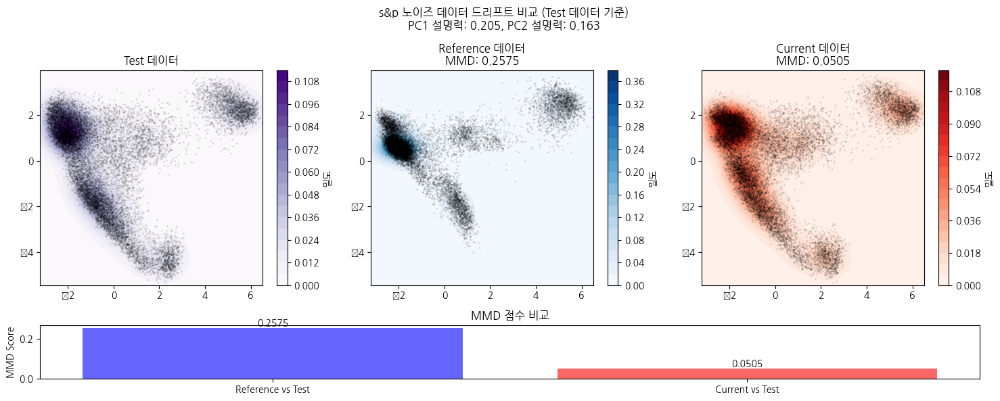

In [22]:
plt.rc('font', family='NanumGothic')
fig = visualize_fixed_projection_drift(
    dfs['ref'].values, dfs['current'].values, dfs['test'].values,
    "s&p 노이즈 데이터 드리프트 비교 (Test 데이터 기준)"
)
plt.show()

/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/events.py:82: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  func(*args, **kwargs)
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


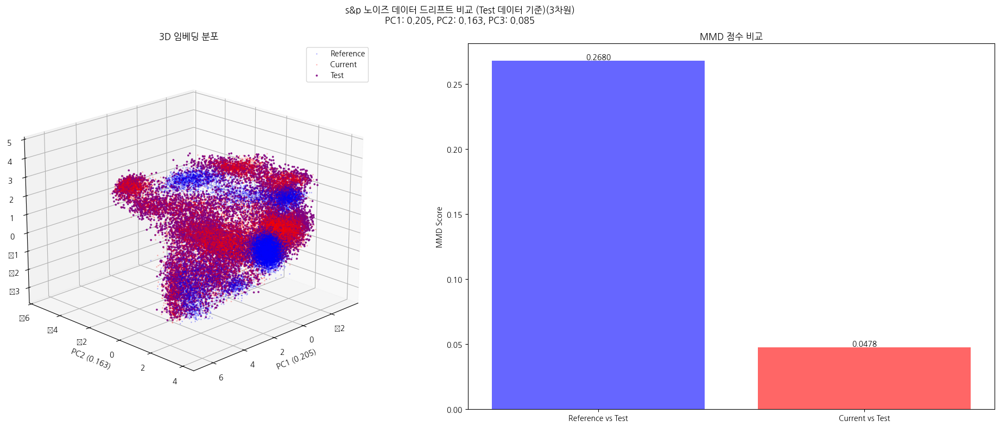

In [25]:
fig = visualize_fixed_projection_drift_3d(
    dfs['ref'].values, dfs['current'].values, dfs['test'].values,
    "s&p 노이즈 데이터 드리프트 비교 (Test 데이터 기준)(3차원)"
)

In [37]:
from IPython.display import HTML
import matplotlib.animation as animation

def visualize_fixed_projection_drift_3d_animated(ref_data, cur_data, test_data, title="3D 임베딩 드리프트 비교"):
    """
    3차원 공간에서 드리프트 시각화 (회전 애니메이션 포함)
    """
    # 1. PCA 3차원 변환
    pca = PCA(n_components=3)
    pca.fit(test_data)
    
    test_transformed = pca.transform(test_data)
    ref_transformed = pca.transform(ref_data)
    cur_transformed = pca.transform(cur_data)
    
    # 2. 시각화
    plt.ioff()  # 인터랙티브 모드 끄기
    fig = plt.figure(figsize=(12, 8))
    
    # 3D 산점도
    ax = fig.add_subplot(111, projection='3d')
    
    # Reference와 Current를 먼저 그리고 더 투명하게
    scatter_ref = ax.scatter(ref_transformed[:, 0], ref_transformed[:, 1], ref_transformed[:, 2], 
                           c='blue', alpha=0.2, s=1, label='Reference')
    scatter_cur = ax.scatter(cur_transformed[:, 0], cur_transformed[:, 1], cur_transformed[:, 2], 
                           c='red', alpha=0.2, s=1, label='Current')
    # Test 데이터를 마지막에 그리고 더 크고 선명하게
    scatter_test = ax.scatter(test_transformed[:, 0], test_transformed[:, 1], test_transformed[:, 2], 
                            c='purple', alpha=0.8, s=3, label='Test')
    
    ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.3f})')
    ax.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.3f})')
    ax.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]:.3f})')
    ax.legend()
    
    plt.suptitle(f'{title}\nPC1: {pca.explained_variance_ratio_[0]:.3f}, '
                f'PC2: {pca.explained_variance_ratio_[1]:.3f}, '
                f'PC3: {pca.explained_variance_ratio_[2]:.3f}')
    
    plt.tight_layout()
    
    # 애니메이션 함수
    def rotate(frame):
        ax.view_init(elev=20, azim=frame)
        return fig,

    # 애니메이션 생성 (0도에서 360도까지 회전)
    anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, 2),
                                 interval=50, blit=False)
    
    # HTML5 비디오로 변환
    return HTML(anim.to_jshtml())


In [38]:
# 사용 예시:
html_animation = visualize_fixed_projection_drift_3d_animated(
    dfs['ref'].values, dfs['current'].values, dfs['test'].values,
    "노이즈 데이터 드리프트 비교 (Test 데이터 기준)(3차원 회전)"
)
html_animation  # 이렇게 하면 노트북에서 애니메이션이 표시됩니다

/tmp/ipykernel_27790/2422656017.py:53: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  return HTML(anim.to_jshtml())
Animation size has reached 21048847 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [39]:
from ultralytics import YOLO

noise_type = "noise_composite"
base_model = "../models/yolov8n.pt"
prj_path = "logs/tlpdr_noise_variations"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


print(f"\n{noise_type} 노이즈 데이터 학습 시작 : ")
model = YOLO(base_model)
model.train(
    data=f"../datasets/{noise_type}_current/dataset.yaml",
    epochs=20,
    imgsz=640,
    device=device,
    project=prj_path,
    name=f"train_{noise_type}",
    exist_ok=True,
)
print(f"{noise_type} 노이즈 데이터 학습 완료")
print(f"학습 결과 저장 경로: {prj_path}/train_{noise_type}")


noise_composite 노이즈 데이터 학습 시작 : 
New https://pypi.org/project/ultralytics/8.3.80 available 😃 Update with 'pip install -U ultralytics'
engine/trainer: task=detect, mode=train, model=../models/yolov8n.pt, data=../datasets/noise_composite_current/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=logs/tlpdr_noise_variations, name=train_noise_composite, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, sh

/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

AMP: checks passed ✅


train: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_current/labels/train... 8954 images, 2 backgrounds, 0 corrupt: 100%|██████████| 8954/8954 [00:08<00:00, 1041.10it/s]


train: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_current/labels/train.cache


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_current/labels/val... 2558 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2558/2558 [00:02<00:00, 896.43it/s] 

val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_current/labels/val.cache


'NoneType' object has no attribute 'remove_callback'
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to logs/tlpdr_noise_variations/train_noise_composite
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/20      2.22G      1.617      1.871      1.062         44        640: 100%|██████████| 560/560 [00:59<00:00,  9.36it/s]
                 Class     Images  Ins

                   all       2558       8782      0.905      0.812      0.893      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/20      2.26G      1.393     0.8856     0.9777         50        640: 100%|██████████| 560/560 [00:57<00:00,  9.68it/s]
                 Class     Images  Ins

                   all       2558       8782      0.905      0.846      0.916       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/20      2.21G      1.324     0.7811     0.9551         50        640: 100%|██████████| 560/560 [00:54<00:00, 10.19it/s]
                 Class     Images  Ins

                   all       2558       8782      0.925      0.842      0.929      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/20      2.19G      1.256     0.7203     0.9445         22        640: 100%|██████████| 560/560 [00:53<00:00, 10.52it/s]
                 Class     Images  Ins

                   all       2558       8782      0.922      0.889      0.946       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/20      2.17G      1.201     0.6701     0.9252         36        640: 100%|██████████| 560/560 [00:54<00:00, 10.21it/s]
                 Class     Images  Ins

                   all       2558       8782      0.937        0.9      0.959      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/20      2.17G      1.167     0.6451     0.9192         29        640: 100%|██████████| 560/560 [00:56<00:00,  9.96it/s]
                 Class     Images  Ins

                   all       2558       8782      0.936      0.911      0.962      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/20      2.15G      1.123     0.6132     0.9083         52        640: 100%|██████████| 560/560 [00:56<00:00,  9.84it/s]
                 Class     Images  Ins

                   all       2558       8782      0.931      0.912      0.963      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/20      2.17G      1.099     0.5941     0.9039         43        640: 100%|██████████| 560/560 [00:53<00:00, 10.41it/s]
                 Class     Images  Ins

                   all       2558       8782      0.935      0.913      0.966       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/20      2.15G      1.075     0.5744     0.9051         67        640: 100%|██████████| 560/560 [00:54<00:00, 10.34it/s]
                 Class     Images  Ins

                   all       2558       8782      0.933      0.919      0.967      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/20      2.15G      1.053     0.5601     0.8962         60        640: 100%|██████████| 560/560 [00:55<00:00, 10.17it/s]
                 Class     Images  Ins

                   all       2558       8782      0.941      0.921      0.969      0.684


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/20      2.15G       0.99     0.5088     0.8764         28        640: 100%|██████████| 560/560 [00:55<00:00, 10.15it/s]
                 Class     Images  Ins

                   all       2558       8782      0.938      0.926      0.972      0.704

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/20      2.17G     0.9604       0.49     0.8707         33        640: 100%|██████████| 560/560 [00:54<00:00, 10.27it/s]
                 Class     Images  Ins

                   all       2558       8782      0.949      0.923      0.973      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/20      2.17G     0.9325     0.4719     0.8623         33        640: 100%|██████████| 560/560 [00:55<00:00, 10.10it/s]
                 Class     Images  Ins

                   all       2558       8782      0.936      0.922      0.972      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/20      2.15G     0.9201     0.4637     0.8587         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.30it/s]
                 Class     Images  Ins

                   all       2558       8782      0.951      0.928      0.976      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/20      2.15G     0.9069     0.4536     0.8571         27        640: 100%|██████████| 560/560 [00:54<00:00, 10.26it/s]
                 Class     Images  Ins

                   all       2558       8782      0.954      0.934      0.977      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/20      2.15G     0.8854     0.4393     0.8527         35        640: 100%|██████████| 560/560 [00:55<00:00, 10.15it/s]
                 Class     Images  Ins

                   all       2558       8782      0.953      0.935      0.978      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/20      2.15G     0.8654     0.4266     0.8475         30        640: 100%|██████████| 560/560 [00:56<00:00, 10.00it/s]
                 Class     Images  Ins

                   all       2558       8782       0.95       0.94      0.979      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/20      2.15G     0.8538     0.4178     0.8438         28        640: 100%|██████████| 560/560 [00:54<00:00, 10.27it/s]
                 Class     Images  Ins

                   all       2558       8782       0.95      0.942       0.98      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/20      2.15G     0.8339     0.4058     0.8398         32        640: 100%|██████████| 560/560 [00:54<00:00, 10.25it/s]
                 Class     Images  Ins

                   all       2558       8782      0.948      0.945      0.979       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/20      2.15G     0.8232     0.3953     0.8388         37        640: 100%|██████████| 560/560 [00:52<00:00, 10.72it/s] 
                 Class     Images  In

                   all       2558       8782      0.952      0.945       0.98      0.742



20 epochs completed in 0.377 hours.
Optimizer stripped from logs/tlpdr_noise_variations/train_noise_composite/weights/last.pt, 6.2MB
Optimizer stripped from logs/tlpdr_noise_variations/train_noise_composite/weights/best.pt, 6.2MB

Validating logs/tlpdr_noise_variations/train_noise_composite/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

                   all       2558       8782      0.952      0.945       0.98      0.742
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to logs/tlpdr_noise_variations/train_noise_composite
noise_composite 노이즈 데이터 학습 완료
학습 결과 저장 경로: logs/tlpdr_noise_variations/train_noise_composite


In [40]:
dataset = fo.load_dataset("noise_composite_test")
dataset.name = "noise_composite_pred"

import os
import json
import random

export_dir = "../datasets/noise_composite_pred"
splits = ['train', 'val', 'test']
split_ratios = [0.7, 0.2, 0.1]  # train/val/test 비율

dataset = fo.load_dataset("noise_composite_pred")
all_samples = list(dataset)
random.shuffle(all_samples)

total_samples = len(all_samples)
train_size = int(total_samples * split_ratios[0])
val_size = int(total_samples * split_ratios[1])

train_samples = all_samples[:train_size]
val_samples = all_samples[train_size:train_size + val_size]
test_samples = all_samples[train_size + val_size:]

split_datasets = []
metadata = {split: {} for split in splits}

for split, samples in zip(splits, [train_samples, val_samples, test_samples]):

    split_dataset = fo.Dataset(f"noise_composite_{split}")
    # 샘플 추가
    for sample in samples:
        split_dataset.add_sample(sample)
        metadata[split][sample.filepath] = sample.noise_type
    # YOLOv5 형식으로 내보내기
    split_dataset.export(
        export_dir=export_dir,
        dataset_type=fo.types.YOLOv5Dataset,
        split=split,
    )
    split_datasets.append(split_dataset)

# noise_type 메타데이터를 JSON 파일로 저장
metadata_path = os.path.join(export_dir, "noise_type_metadata.json")
with open(metadata_path, 'w') as f:
    json.dump(metadata, f, indent=4)

print(f"데이터셋이 {export_dir}에 YOLOv5 형식으로 저장되었습니다.")
print(f"noise_type 메타데이터가 {metadata_path}에 저장되었습니다.")
print("\n분할 별 샘플 수:")
for split, split_dataset in zip(splits, split_datasets):
    print(f"{split}: {len(split_dataset)}")

 100% |███████████████| 8954/8954 [14.0s elapsed, 0s remaining, 584.1 samples/s]      
Directory '../datasets/noise_composite_pred' already exists; export will be merged with existing files
 100% |███████████████| 2558/2558 [5.4s elapsed, 0s remaining, 664.2 samples/s]      
Directory '../datasets/noise_composite_pred' already exists; export will be merged with existing files
 100% |███████████████| 1280/1280 [2.0s elapsed, 0s remaining, 653.6 samples/s]      
데이터셋이 ../datasets/noise_composite_pred에 YOLOv5 형식으로 저장되었습니다.
noise_type 메타데이터가 ../datasets/noise_composite_pred/noise_type_metadata.json에 저장되었습니다.

분할 별 샘플 수:
train: 8954
val: 2558
test: 1280


In [44]:
def evaluate_single_noise_model(ref_model, noise_type, prj_path="logs/tlpdr_noise_variations"):
    """
    단일 노이즈 타입에 대한 레퍼런스 모델과 current 모델의 성능을 평가하고 결과를 반환
    """
    results = {
        'model_type': [],
        'mAP': [],      # mAP@0.5:0.95
        'mAP50': [],    # mAP@0.5
        'mAP75': [],    # mAP@0.75
        'precision': [],
        'recall': []
    }
    
    print(f"\n{noise_type} 노이즈 데이터 평가 중...")
    
    # Current 모델 로드
    cur_model = YOLO(f"{prj_path}/train_{noise_type}/weights/best.pt")
    # 테스트 데이터셋 경로
    test_data = f"../datasets/{noise_type}_pred/test_config.yaml"
    
    # 모델 평가 및 결과 저장
    for model_type, model in [('Reference', ref_model), ('Current', cur_model)]:
        # 평가 결과 저장 경로 설정
        save_dir = f"{prj_path}/val_{noise_type}_{model_type.lower()}"
        
        # 모델 평가
        metrics = model.val(
            data=test_data,
            project=prj_path,
            name=f"val_{noise_type}_{model_type.lower()}",
            exist_ok=True
        )
    
        # 결과 저장
        results['model_type'].append(model_type)
        results['mAP'].append(metrics.box.map)
        results['mAP50'].append(metrics.box.map50)
        results['mAP75'].append(metrics.box.map75)
        results['precision'].append(metrics.box.p)
        results['recall'].append(metrics.box.r)
        
        print(f"{noise_type} {model_type} 모델 평가 완료 - 저장 경로: {save_dir}")
    
    return pd.DataFrame(results)

def plot_single_noise_comparison(results_df, noise_type, title=None):
    """
    단일 노이즈 타입에 대한 성능 비교 시각화
    """
    if title is None:
        title = f"{noise_type} 노이즈 모델 성능 비교"
    
    # 수치형 컬럼들을 float 타입으로 변환
    numeric_columns = ['mAP', 'mAP50', 'mAP75', 'precision', 'recall']
    for col in numeric_columns:
        results_df[col] = results_df[col].astype(float)
    
    fig = plt.figure(figsize=(15, 10))
    gs = plt.GridSpec(2, 2, height_ratios=[2, 1])
    
    # 1. mAP 메트릭들을 위한 막대 그래프
    ax1 = plt.subplot(gs[0, :])
    x = np.arange(3)
    width = 0.35
    
    ref_data = results_df[results_df['model_type'] == 'Reference']
    cur_data = results_df[results_df['model_type'] == 'Current']
    
    # mAP 막대 그래프
    ax1.bar(x - width/2, [ref_data['mAP'].iloc[0], ref_data['mAP50'].iloc[0], ref_data['mAP75'].iloc[0]], 
            width, label='Reference', color='blue', alpha=0.6)
    ax1.bar(x + width/2, [cur_data['mAP'].iloc[0], cur_data['mAP50'].iloc[0], cur_data['mAP75'].iloc[0]], 
            width, label='Current', color='red', alpha=0.6)
    
    # 성능 차이 표시
    for i in range(3):
        metrics = ['mAP', 'mAP50', 'mAP75']
        diff = cur_data[metrics[i]].iloc[0] - ref_data[metrics[i]].iloc[0]
        color = '#2ecc71' if diff > 0 else '#e74c3c'
        ax1.text(i, max(cur_data[metrics[i]].iloc[0], ref_data[metrics[i]].iloc[0]) + 0.01,
                f'{diff:+.3f}', ha='center', va='bottom', color=color)
    
    ax1.set_ylabel('Score')
    ax1.set_title('mAP Metrics Comparison')
    ax1.set_xticks(x)
    ax1.set_xticklabels(['mAP', 'mAP50', 'mAP75'])
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    
    # 2. Precision-Recall 점 그래프
    ax2 = plt.subplot(gs[1, :])
    models = ['Reference', 'Current']
    colors = ['blue', 'red']
    markers = ['o', 's']
    
    for model, color, marker in zip(models, colors, markers):
        model_data = results_df[results_df['model_type'] == model]
        ax2.scatter(model_data['recall'], model_data['precision'], 
                   color=color, marker=marker, s=200, alpha=0.6, 
                   label=f'{model}')
    
    # 화살표로 변화 표시
    ax2.annotate('',
                xy=(cur_data['recall'].iloc[0], cur_data['precision'].iloc[0]),
                xytext=(ref_data['recall'].iloc[0], ref_data['precision'].iloc[0]),
                arrowprops=dict(arrowstyle='->', color='gray', alpha=0.6))
    
    ax2.set_xlabel('Recall')
    ax2.set_ylabel('Precision')
    ax2.set_title('Precision vs Recall')
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    
    plt.suptitle(title, y=1.02, fontsize=14)
    plt.tight_layout()
    
    return fig

In [45]:
# 사용 예시:
noise_type = "noise_composite"  # 평가하고자 하는 노이즈 타입
ref_model = YOLO("./logs/tlpdr_noise/train_ref/weights/best.pt")
prj_path = "logs/tlpdr_noise_variations"

In [46]:
# 평가 수행
results = evaluate_single_noise_model(ref_model, noise_type, prj_path)


noise_composite 노이즈 데이터 평가 중...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)


Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_pred/labels/test... 12792 images, 14 backgrounds, 0 corrupt: 100%|██████████| 12792/12792 [00:11<00:00, 1091.56it/s]


val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_pred/labels/test.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 800/800 [01:09<00:00, 11.43it/s]


                   all      12792      44200       0.73      0.503      0.619      0.407
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to logs/tlpdr_noise_variations/val_noise_composite_reference
noise_composite Reference 모델 평가 완료 - 저장 경로: logs/tlpdr_noise_variations/val_noise_composite_reference
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/noise_composite_pred/labels/test.cache... 12792 images, 14 backgrounds, 0 corrupt: 100%|██████████| 12792/12792 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 800/800 [01:23<00:00,  9.55it/s]


                   all      12792      44200      0.946       0.91      0.964      0.706
Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to logs/tlpdr_noise_variations/val_noise_composite_current
noise_composite Current 모델 평가 완료 - 저장 경로: logs/tlpdr_noise_variations/val_noise_composite_current


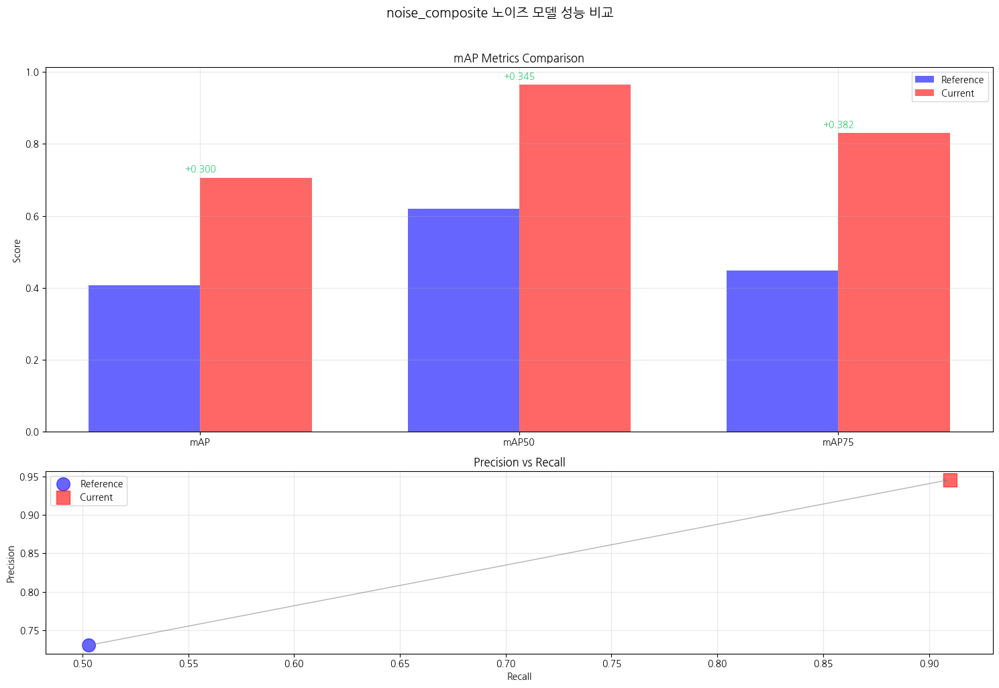

In [48]:
%matplotlib inline
# 결과 시각화
fig = plot_single_noise_comparison(results, noise_type)
plt.show()

In [54]:
def evaluate_model_on_noise_types(model, noise_types, prj_path="logs/tlpdr_noise_variations"):
    """
    하나의 모델에 대해 여러 노이즈 타입별 추론 성능을 평가
    
    Args:
        model: 평가할 YOLO 모델
        noise_types: 평가할 노이즈 타입 리스트 (예: ['gaus', 'snp', 'motion_blur', 'dark'])
        prj_path: 프로젝트 경로
    """
    all_results = []
    
    for noise_type in noise_types:
        print(f"\n{noise_type} 노이즈 데이터에 대한 추론 평가 중...")
        
        # 테스트 데이터셋 경로
        test_data = f"../datasets/{noise_type}_test/test_config.yaml"
        
        # 모델 평가
        metrics = model.val(
            data=test_data,
            project=prj_path,
            name=f"val_{noise_type}",
            exist_ok=True
        )
        
        # 결과 저장
        result = {
            'noise_type': noise_type,
            'mAP': metrics.box.map,
            'mAP50': metrics.box.map50,
            'mAP75': metrics.box.map75,
            'precision': metrics.box.p,
            'recall': metrics.box.r
        }
        all_results.append(result)
        
        print(f"{noise_type} 노이즈 평가 완료")
    
    return pd.DataFrame(all_results)

def plot_noise_performance_comparison(results_df, title="노이즈 타입별 모델 성능 비교"):
    """
    여러 노이즈 타입에 대한 모델의 성능 비교 시각화
    """
    # 그래프 설정
    fig = plt.figure(figsize=(15, 10))
    gs = plt.GridSpec(2, 1, height_ratios=[2, 1])
    
    # 1. mAP 비교 (상단)
    ax1 = plt.subplot(gs[0])
    noise_types = results_df['noise_type']
    x = np.arange(len(noise_types))
    width = 0.2
    
    metrics = ['mAP', 'mAP50', 'mAP75']
    colors = ['#3498db', '#2ecc71', '#e74c3c']
    
    for i, (metric, color) in enumerate(zip(metrics, colors)):
        values = results_df[metric]
        bars = ax1.bar(x + (i-1)*width, values, width, label=metric, 
                      alpha=0.7, color=color)
        
        # 값 표시
        for bar in bars:
            height = bar.get_height()
            ax1.text(bar.get_x() + bar.get_width()/2., height,
                    f'{height:.3f}', ha='center', va='bottom')
    
    ax1.set_ylabel('Score')
    ax1.set_title('mAP Metrics by Noise Type')
    ax1.set_xticks(x)
    ax1.set_xticklabels(noise_types, rotation=45)
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    
    # 2. Precision-Recall 산점도 (하단)
    ax2 = plt.subplot(gs[1])
    
    scatter = ax2.scatter(results_df['recall'], results_df['precision'], 
                         c=np.arange(len(noise_types)), cmap='viridis', 
                         s=200, alpha=0.6)
    
    # 점에 노이즈 타입 레이블 추가
    for i, noise_type in enumerate(noise_types):
        ax2.annotate(noise_type, 
                    (results_df['recall'].iloc[i], results_df['precision'].iloc[i]),
                    xytext=(5, 5), textcoords='offset points')
    
    ax2.set_xlabel('Recall')
    ax2.set_ylabel('Precision')
    ax2.set_title('Precision vs Recall by Noise Type')
    ax2.grid(True, alpha=0.3)
    
    plt.suptitle(title, y=1.02, fontsize=14)
    plt.tight_layout()
    
    return fig

def print_noise_performance_table(results_df):
    """
    노이즈 타입별 성능 결과를 표 형식으로 출력
    """
    print("\n노이즈 타입별 성능 결과:")
    print("=" * 80)
    
    # NumPy 배열을 float로 변환하여 포맷팅
    formatted_df = results_df.copy()
    numeric_columns = ['mAP', 'mAP50', 'mAP75', 'precision', 'recall']
    
    for col in numeric_columns:
        formatted_df[col] = formatted_df[col].astype(float).apply(lambda x: f"{x:.4f}")
    
    print(formatted_df.to_string(index=False))
    print("=" * 80)

In [52]:
# 사용 예시:
noise_types = ['gaus', 'snp', 'motion_blur', 'dark']
current_model = YOLO("./logs/tlpdr_noise_variations/train_noise_composite/weights/best.pt")

# 평가 수행
results = evaluate_model_on_noise_types(current_model, noise_types)


gaus 노이즈 데이터에 대한 추론 평가 중...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)


Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/gaus_test/labels/test... 12792 images, 13 backgrounds, 0 corrupt: 100%|██████████| 12792/12792 [00:10<00:00, 1270.04it/s]

val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/gaus_test/labels/test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 800/800 [01:19<00:00, 10.04it/s]


                   all      12792      44192      0.962      0.943      0.981      0.758
Speed: 0.1ms preprocess, 1.5ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to logs/tlpdr_noise_variations/val_gaus
gaus 노이즈 평가 완료

snp 노이즈 데이터에 대한 추론 평가 중...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/snp_test/labels/test.cache... 12792 images, 13 backgrounds, 0 corrupt: 100%|██████████| 12792/12792 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 800/800 [01:14<00:00, 10.76it/s]


                   all      12792      44192      0.963      0.948      0.983      0.757
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to logs/tlpdr_noise_variations/val_snp
snp 노이즈 평가 완료

motion_blur 노이즈 데이터에 대한 추론 평가 중...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/motion_blur_test/labels/test.cache... 12792 images, 13 backgrounds, 0 corrupt: 100%|██████████| 12792/12792 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 800/800 [01:35<00:00,  8.40it/s]


                   all      12792      44192       0.88      0.802      0.887      0.511
Speed: 0.2ms preprocess, 1.9ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to logs/tlpdr_noise_variations/val_motion_blur
motion_blur 노이즈 평가 완료

dark 노이즈 데이터에 대한 추론 평가 중...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/dark_test/labels/test.cache... 12792 images, 13 backgrounds, 0 corrupt: 100%|██████████| 12792/12792 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 800/800 [01:22<00:00,  9.64it/s]


                   all      12792      44192      0.962      0.953      0.985      0.767
Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to logs/tlpdr_noise_variations/val_dark
dark 노이즈 평가 완료


In [55]:
# 상세 결과 출력
print_noise_performance_table(results)


노이즈 타입별 성능 결과:
 noise_type    mAP  mAP50  mAP75 precision recall
       gaus 0.7583 0.9811 0.9083    0.9620 0.9427
        snp 0.7570 0.9826 0.9082    0.9628 0.9478
motion_blur 0.5112 0.8865 0.5304    0.8796 0.8021
       dark 0.7668 0.9852 0.9181    0.9623 0.9528


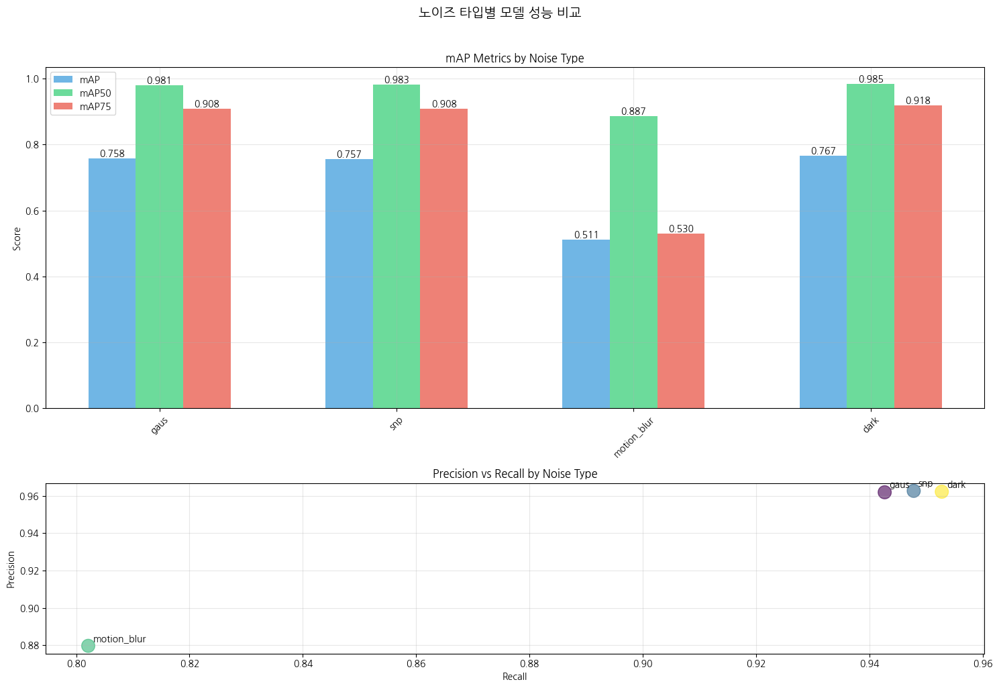

In [56]:
# 결과 시각화
fig = plot_noise_performance_comparison(results)
plt.show()

In [57]:
results.to_csv(f"{prj_path}/evaluation_results_composite.csv", index=False)

In [80]:
def compare_noise_model_performances(single_results_path, composite_results_path, noise_types):
    # 데이터 로드 및 전처리
    single_df = pd.read_csv(single_results_path)
    composite_df = pd.read_csv(composite_results_path)
    
    # 공통된 노이즈 타입만 선택
    common_noise_types = list(set(single_df['noise_type'].unique()) & 
                            set(composite_df['noise_type'].unique()))
    
    # 데이터 필터링
    single_df = single_df[single_df['noise_type'].isin(common_noise_types)]
    composite_df = composite_df[composite_df['noise_type'].isin(common_noise_types)]
    
    # precision과 recall 컬럼 전처리
    for df in [single_df, composite_df]:
        df['precision'] = df['precision'].apply(lambda x: float(x.strip('[]')))
        df['recall'] = df['recall'].apply(lambda x: float(x.strip('[]')))
    
    # Reference와 Current 모델 분리
    single_ref = single_df[single_df['model_type'] == 'Reference']
    single_cur = single_df[single_df['model_type'] == 'Current']
    
    # 시각화 설정
    fig = plt.figure(figsize=(15, 25))
    gs = plt.GridSpec(4, 1, height_ratios=[1.2, 1, 1, 1.2])
    
    # 색상 및 스타일 설정
    colors = {
        'reference': '#D3D3D3',  # 연한 회색으로 변경
        'single': '#2E86AB',     # 선명한 파랑
        'composite': '#D1495B'   # 선명한 빨강
    }
    
    styles = {
        'reference': {'alpha': 0.3, 'linestyle': ':'},  # 점선, 투명도 높게
        'single': {'alpha': 0.8, 'linestyle': '-'},     # 실선, 선명하게
        'composite': {'alpha': 0.8, 'linestyle': '-'}   # 실선, 선명하게
    }
    
    # 1. mAP, Precision, Recall 비교
    ax1 = plt.subplot(gs[0])
    x = np.arange(len(common_noise_types))
    width = 0.25  # bar 너비 증가
    
    metrics = ['mAP', 'precision', 'recall']
    for i, metric in enumerate(metrics):
        # Reference는 작게 표시
        ax1.bar(x + (i-1)*width, single_ref[metric], width*0.8, 
                label=f'Reference ({metric})', 
                color=colors['reference'], 
                alpha=styles['reference']['alpha'])
        # Single과 Composite는 크고 선명하게
        ax1.bar(x + i*width, single_cur[metric], width, 
                label=f'Single ({metric})',
                color=colors['single'],
                alpha=styles['single']['alpha'])
        ax1.bar(x + (i+1)*width, composite_df[metric], width,
                label=f'Composite ({metric})',
                color=colors['composite'],
                alpha=styles['composite']['alpha'])
    
    ax1.set_ylabel('Score', fontsize=12)
    ax1.set_title('노이즈 타입별 모델 성능 비교', fontsize=14)
    ax1.set_xticks(x + width)
    ax1.set_xticklabels(common_noise_types, rotation=45)
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax1.grid(True, alpha=0.3)
    
    # 2. Precision 비교
    ax2 = plt.subplot(gs[1])
    # Reference는 얇은 점선으로
    ax2.plot(range(len(common_noise_types)), single_ref['precision'], 'o:',
             label='Reference', color=colors['reference'], 
             linewidth=1, markersize=6, alpha=styles['reference']['alpha'])
    # Single과 Composite는 굵은 실선으로
    ax2.plot(range(len(common_noise_types)), single_cur['precision'], 's-',
             label='Single', color=colors['single'], 
             linewidth=2.5, markersize=10, alpha=styles['single']['alpha'])
    ax2.plot(range(len(common_noise_types)), composite_df['precision'], '^-',
             label='Composite', color=colors['composite'], 
             linewidth=2.5, markersize=10, alpha=styles['composite']['alpha'])
    
    # Single과 Composite 사이 영역 강조
    ax2.fill_between(range(len(common_noise_types)), 
                    single_cur['precision'], composite_df['precision'],
                    color='gray', alpha=0.1)
    
    ax2.set_ylabel('Precision', fontsize=12)
    ax2.set_title('Precision Comparison', fontsize=14)
    ax2.set_xticks(range(len(common_noise_types)))
    ax2.set_xticklabels(common_noise_types, rotation=45)
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    # 3. Recall 비교 (Precision과 동일한 스타일 적용)
    ax3 = plt.subplot(gs[2])
    ax3.plot(range(len(common_noise_types)), single_ref['recall'], 'o:',
             label='Reference', color=colors['reference'], 
             linewidth=1, markersize=6, alpha=styles['reference']['alpha'])
    ax3.plot(range(len(common_noise_types)), single_cur['recall'], 's-',
             label='Single', color=colors['single'], 
             linewidth=2.5, markersize=10, alpha=styles['single']['alpha'])
    ax3.plot(range(len(common_noise_types)), composite_df['recall'], '^-',
             label='Composite', color=colors['composite'], 
             linewidth=2.5, markersize=10, alpha=styles['composite']['alpha'])
    
    # Single과 Composite 사이 영역 강조
    ax3.fill_between(range(len(common_noise_types)), 
                    single_cur['recall'], composite_df['recall'],
                    color='gray', alpha=0.1)
    
    ax3.set_ylabel('Recall', fontsize=12)
    ax3.set_title('Recall Comparison', fontsize=14)
    ax3.set_xticks(range(len(common_noise_types)))
    ax3.set_xticklabels(common_noise_types, rotation=45)
    ax3.legend()
    ax3.grid(True, alpha=0.3)
    
    # 4. 성능 차이 히트맵
    ax4 = plt.subplot(gs[3])
    metrics = ['mAP', 'mAP50', 'mAP75', 'precision', 'recall']
    diff_data = []
    
    for nt in common_noise_types:
        single_data = single_cur[single_cur['noise_type'] == nt]
        composite_data = composite_df[composite_df['noise_type'] == nt]
        
        diffs = [composite_data[metric].iloc[0] - single_data[metric].iloc[0] 
                 for metric in metrics]
        diff_data.append(diffs)
    
    # 히트맵 색상 강화
    im = ax4.imshow(diff_data, cmap='RdYlBu_r', aspect='auto', vmin=-0.1, vmax=0.1)
    plt.colorbar(im, ax=ax4, label='Performance Difference (Composite - Single)')
    
    ax4.set_xticks(np.arange(len(metrics)))
    ax4.set_yticks(np.arange(len(common_noise_types)))
    ax4.set_xticklabels(metrics)
    ax4.set_yticklabels(common_noise_types)
    
    # 히트맵에 값 표시
    for i in range(len(common_noise_types)):
        for j in range(len(metrics)):
            text = ax4.text(j, i, f'{diff_data[i][j]:.3f}',
                          ha="center", va="center",
                          color="black" if abs(diff_data[i][j]) < 0.5 else "white")
    
    ax4.set_title('Performance Difference (Composite - Single)', fontsize=14)
    
    plt.suptitle('Single vs Composite 노이즈 모델 성능 비교',  # 제목 변경
                fontsize=16, y=0.95)
    plt.tight_layout()
    return fig

/tmp/ipykernel_27790/3468346840.py:152: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


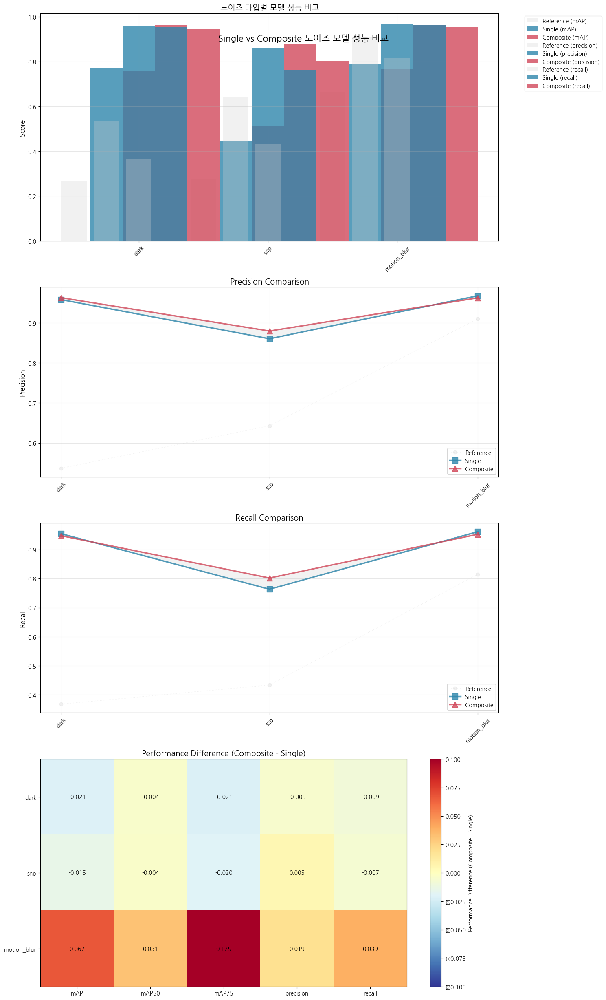

In [81]:
# 사용 예시:
noise_types = ['gaus', 'snp', 'motion_blur', 'dark']
single_results_path = "./logs/tlpdr_noise_variations/evaluation_results.csv"
composite_results_path = "./logs/tlpdr_noise_variations/evaluation_results_composite.csv"

plt.rc('font', family='NanumGothic')
fig = compare_noise_model_performances(single_results_path, composite_results_path, noise_types)
plt.show()